# Sign Detection using Tensorflow

In [1]:
import cv2
import pandas as pd
import pathlib
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

### Setup

https://github.com/tensorflow/models/tree/master/research/object_detection

https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md

```bash
git clone https://github.com/tensorflow/models
pip install --user Cython
pip install --user contextlib2
pip install --user pillow
pip install --user lxml
pip install --user jupyter
pip install --user matplotlib
```

```bash
bin/protoc  object_detection/protos/*.proto --python_out=.
```

## Load Images

In [2]:
annotations_dir = "dataset_short/annotations"
images_dir = "dataset_short/images"

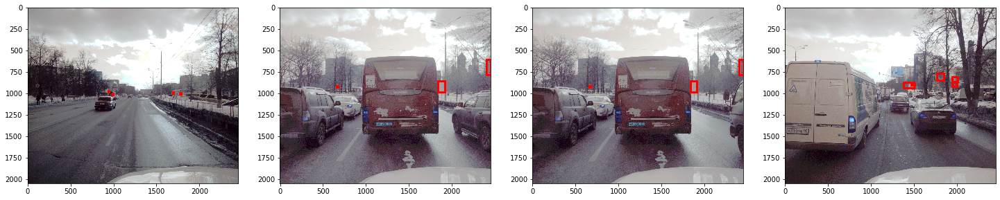

In [3]:
ann_train_dir = pathlib.Path(annotations_dir) / "train"
img_train_dir = pathlib.Path(images_dir) / "train"

fig,ax = plt.subplots(1, 4, figsize=(25,25))      
i = 0 
for x in img_train_dir.iterdir():
    for img_name in list(x.iterdir())[:4]:
        tsv_name = img_name.name[:-3] + "tsv"
        ann_name = ann_train_dir / x.name / tsv_name
        img = cv2.imread(str(img_name.resolve()))
#         plt.imshow(img)
        ax[i].imshow(img)
        df = pd.read_csv(ann_name, sep="\t")
        for j, box in df.iterrows():
            crop_img = img[box.ytl:box.ybr, box.xtl:box.xbr]
            rect = plt.Rectangle((box.xtl, box.ytl), box.xbr-box.xtl, box.ybr-box.ytl,fill=False, edgecolor='red', linewidth=3)
            ax[i].add_patch(rect)        
        i += 1
    plt.show()
    break

In [6]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
tf.enable_eager_execution() 
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display
import pathlib

In [7]:
import sys
sys.path.insert(0, "models/research")

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

## Loader

In [8]:
def load_model(model_name):
    base_url = 'http://download.tensorflow.org/models/object_detection/'
    model_file = model_name + '.tar.gz'
    model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

    model_dir = pathlib.Path(model_dir)/"saved_model"

#     model = tf.saved_model.load(str(model_dir), None)
    model = tf.compat.v2.saved_model.load(str(model_dir), None)
    model = model.signatures['serving_default']

    return model

In [9]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [34]:
# https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md
model_name = 'ssd_inception_v2_coco_2017_11_17'
detection_model = load_model(model_name)

278126592/278126337 [==============================] - 5s 0us/step


In [35]:
print(detection_model.inputs)

[<tf.Tensor 'image_tensor:0' shape=(?, ?, ?, 3) dtype=uint8>]


In [36]:
detection_model.output_dtypes

{'detection_scores': tf.float32,
 'detection_classes': tf.float32,
 'num_detections': tf.float32,
 'detection_boxes': tf.float32}

In [37]:
detection_model.output_shapes

{'detection_scores': TensorShape([Dimension(None), Dimension(100)]),
 'detection_classes': TensorShape([Dimension(None), Dimension(100)]),
 'num_detections': TensorShape([Dimension(None)]),
 'detection_boxes': TensorShape([Dimension(None), Dimension(100), Dimension(4)])}

In [38]:
def run_inference_for_single_image(model, image):
    image = np.asarray(image)
    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis,...]

    # Run inference
    output_dict = model(input_tensor)
    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(output_dict.pop('num_detections').numpy())
    output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections

    # detection_classes should be ints.
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

    # Handle models with masks:
    if 'detection_masks' in output_dict:
        # Reframe the the bbox mask to the image size.
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                  output_dict['detection_masks'], output_dict['detection_boxes'],
                   image.shape[0], image.shape[1])      
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                           tf.uint8)
        output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

    return output_dict

In [39]:
def show_inference(model, image_path):
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = np.array(Image.open(image_path))
    # Actual detection.
    output_dict = run_inference_for_single_image(model, image_np)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

    display(Image.fromarray(image_np))

## Testing coco model

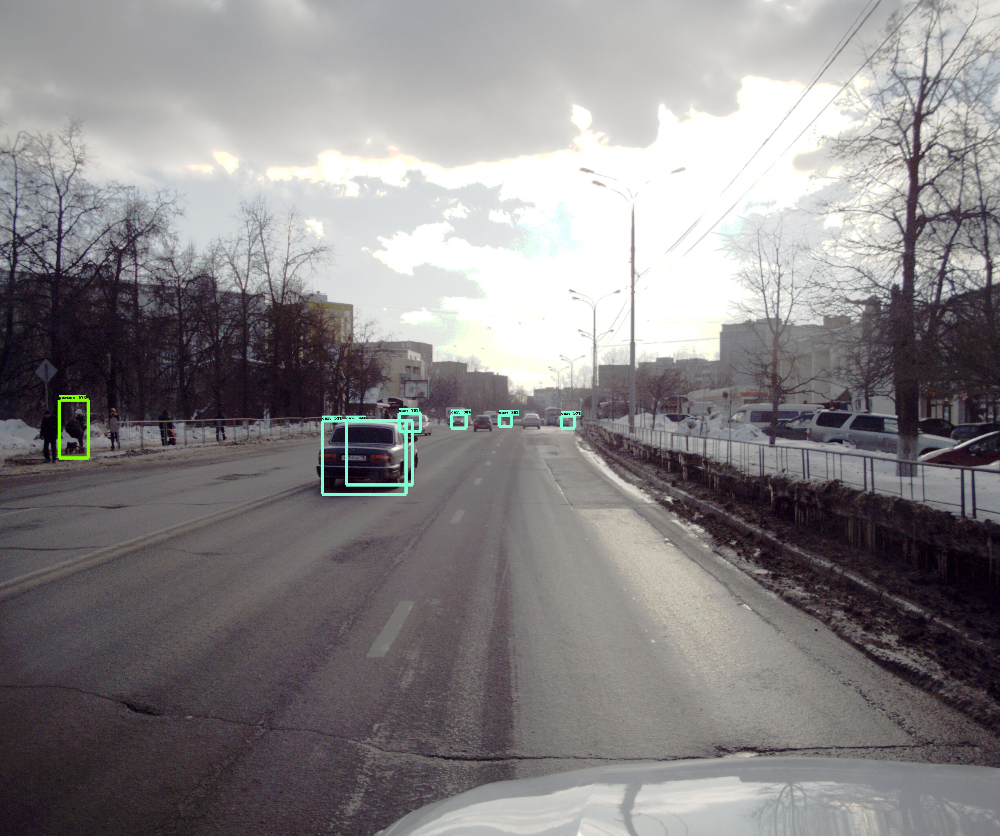

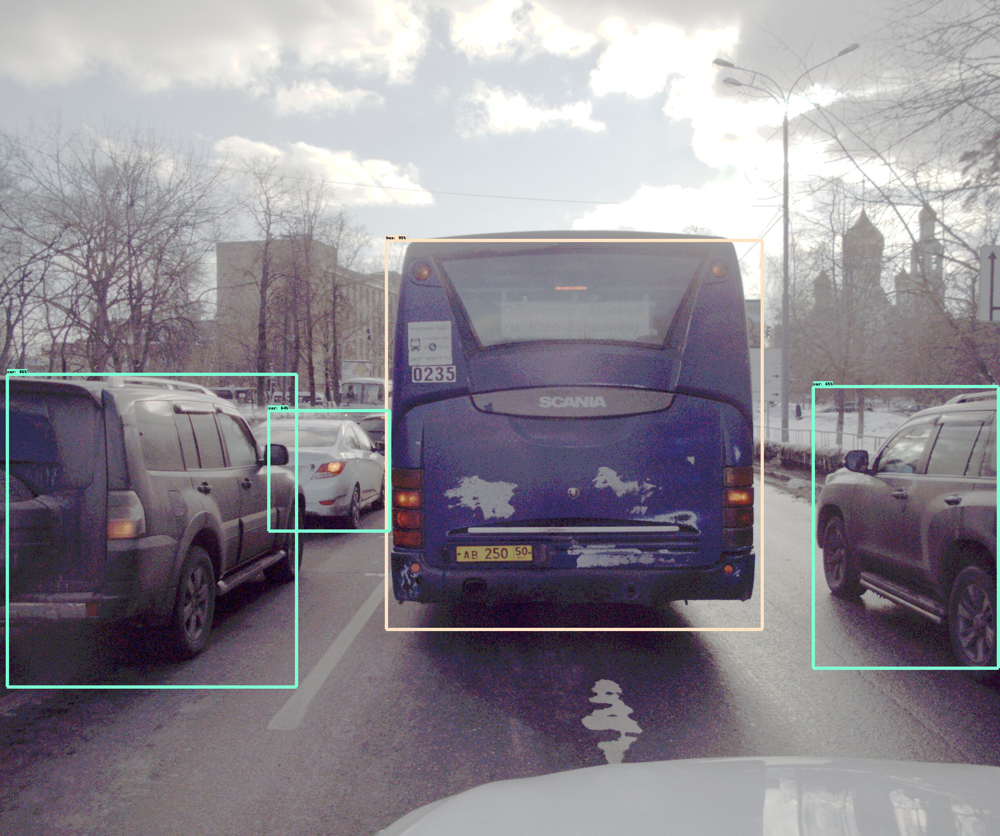

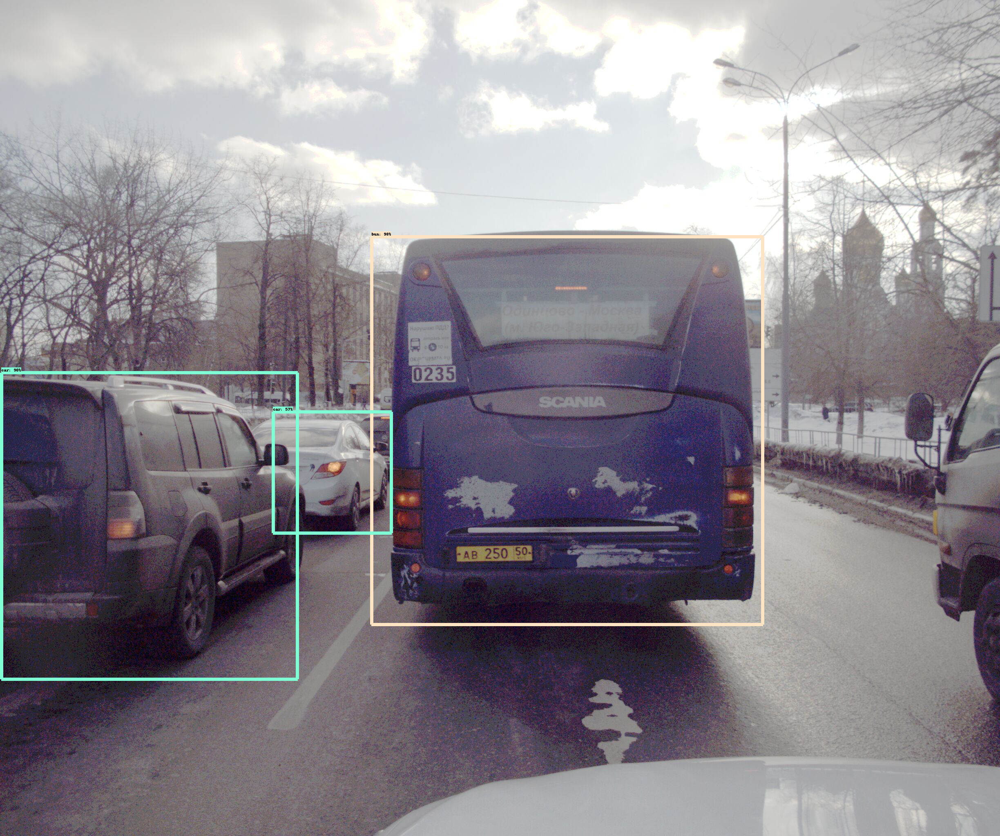

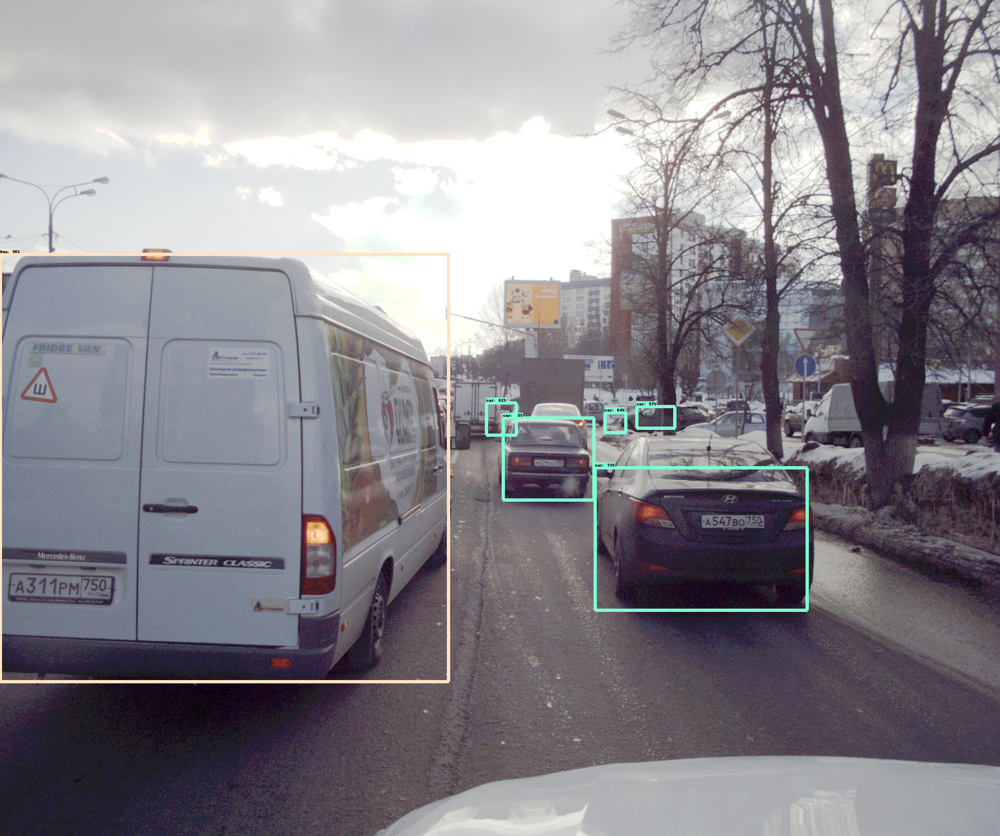

<Figure size 1800x1800 with 0 Axes>

In [40]:
ann_train_dir = pathlib.Path(annotations_dir) / "train"
img_train_dir = pathlib.Path(images_dir) / "train"

plt.figure(figsize=(25,25))
for x in img_train_dir.iterdir():
    for img_name in list(x.iterdir())[:4]:
        tsv_name = img_name.name[:-3] + "tsv"
        ann_name = ann_train_dir / x.name / tsv_name
        show_inference(detection_model, str(img_name.resolve()))
    break

## Generate TFRecords

In [22]:
from object_detection.utils import dataset_util


def txt2tfrecords(base_dir):
    writer = tf.io.TFRecordWriter(base_dir)
    ann_train_dir = pathlib.Path(annotations_dir) / "test"
    img_train_dir = pathlib.Path(images_dir) / "test"

    for x in img_train_dir.iterdir():
        for img_name in list(x.iterdir()):
            tsv_name = img_name.name[:-3] + "tsv"
            ann_name = ann_train_dir / x.name / tsv_name
            img = cv2.imread(str(img_name.resolve()))
            img = cv2.resize(img, (2448, 2048)) 
            
            df = pd.read_csv(ann_name, sep="\t")
            height = img.shape[0]
            width = img.shape[1]
            filename = str(img_name.resolve()).encode(encoding='UTF-8',errors='strict')
            with tf.io.gfile.GFile(str(img_name.resolve()), 'rb') as fid:
                encoded_jpg = fid.read()
            encoded_image_data = encoded_jpg # Encoded image bytes
            image_format = img_name.suffix[1:].encode(encoding='UTF-8',errors='strict') # b'jpeg' or b'png'

            # List of normalized left x coordinates in bounding box (1 per box)
            xmins = [box.xtl for _, box in df.iterrows()]
            # List of normalized right x coordinates in bounding box
            xmaxs = [box.xbr for _, box in df.iterrows()]
            # List of normalized top y coordinates in bounding box (1 per box)
            ymins = [box.ytl for _, box in df.iterrows()] 
            # List of normalized bottom y coordinates in bounding box
            ymaxs = [box.ybr for _, box in df.iterrows()] 
            # List of string class name of bounding box (1 per box)
            classes_text = ['sign'.encode(encoding='UTF-8',errors='strict') for _, box in df.iterrows()] 
            # List of integer class id of bounding box (1 per box)
            classes = [1 for _, box in df.iterrows()] 

            tf_example = tf.train.Example(features=tf.train.Features(feature={
              'image/height': dataset_util.int64_feature(height),
              'image/width': dataset_util.int64_feature(width),
              'image/filename': dataset_util.bytes_feature(filename),
              'image/source_id': dataset_util.bytes_feature(filename),
              'image/encoded': dataset_util.bytes_feature(encoded_image_data),
              'image/format': dataset_util.bytes_feature(image_format),
              'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
              'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
              'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
              'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
              'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
              'image/object/class/label': dataset_util.int64_list_feature(classes),
            }))
            writer.write(tf_example.SerializeToString())       

In [21]:
txt2tfrecords('train_records')

In [23]:
txt2tfrecords('test_records')

## Running model

In [ ]:
!export PYTHONPATH=models/research/slim:models/research:$PYTHONPATH:. && \
        python models/research/object_detection/model_main.py \
    --pipeline_config_path=sign.config \
    --model_dir=model_dir \
    --alsologtostderr

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 